In [1]:
from selective_recruitment.scripts.script_plot_activation import plot_activation_map
from selective_recruitment.scripts.script_plot_roi_figures import plot_parcels_single, plot_parcels_super
from selective_recruitment.scripts.script_plot_connectivity_map import plot_connectivity_weight
from selective_recruitment.scripts.script_mapwise import load_data, plot_data_flat, calc_ttest_mean

import selective_recruitment.recruite_ana as ra
import selective_recruitment.globals as gl
import selective_recruitment.scripts.script_prep_sc as ss
import selective_recruitment.plotting as plotting

import Functional_Fusion.atlas_map as am


from statsmodels.stats.anova import AnovaRM  # perform F test
from scipy.stats import ttest_rel


from pathlib import Path
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

In [2]:
# setting working directory
# wkdir = '/Volumes/diedrichsen_data$/data/Cerebellum/Demand/selective_recruit'
wkdir = 'A:\data\Cerebellum\CerebellumWorkingMemory\selective_recruit'
if not Path(wkdir).exists():
    wkdir = '/srv/diedrichsen/data/Cerebellum/CerebellumWorkingMemory/selective_recruit'
if not Path(wkdir).exists():
    wkdir = '/Users/jdiedrichsen/Data/wm_cerebellum/selective_recruit'

# Activation maps
plot shows activations averaged across conditions and subjects

## finger sequence task

In [3]:
# cerebellum
ax = plot_activation_map(dataset = "WMFS", 
                         ses_id = "ses-01", 
                         subj = "group",
                         type = "CondHalf", 
                         atlas_space = "SUIT3", 
                         contrast_name = "average", 
                         cmap = "coolwarm",
                         cscale = [-0.1, 0.1],  
                         smooth = None)
ax

/home/ROBARTS/lshahsha/Documents/Projects/selective_recruitment/scripts/script_plot_activation.py:44: RuntimeWarning: Mean of empty slice
  dat_con = np.nanmean(data[0, idx, :], axis = 0)
/home/ROBARTS/lshahsha/Documents/Projects/selective_recruitment/env/lib/python3.9/site-packages/SUITPy/flatmap.py:222: RuntimeWarning: Mean of empty slice
  mapped_data[:,index[v]:index[v+1]] = np.nanmean(data,axis=0)


In [4]:
ax = plot_activation_map(dataset = "WMFS", 
                         ses_id = "ses-01", 
                         subj = "group",
                         type = "CondHalf", 
                         atlas_space = "fs32k", 
                         contrast_name = "average", 
                         cmap = "coolwarm",
                         cscale = [-0.2, 0.2], 
                         smooth = None)
ax[0]

/home/ROBARTS/lshahsha/Documents/Projects/selective_recruitment/env/lib/python3.9/site-packages/nilearn/plotting/js_plotting_utils.py:81: UserWarning:

vmin cannot be chosen when cmap is symmetric



# Average connectivity maps for the selected region of interest
Regions are selected from the hierarchical parcellation (NettekovenSym68c32)

In [5]:
# right hand motor area 
parcellation = "NettekovenSym68c32"
roi_name = "M3R"
ax2 = plot_parcels_single(label = parcellation, roi_name = roi_name)
ax2.show()
# plot_parcels_super(label = "NettekovenSym68c32", roi_super = "M")

/home/ROBARTS/lshahsha/Documents/Projects/selective_recruitment/env/lib/python3.9/site-packages/SUITPy/flatmap.py:582: RuntimeWarning:

invalid value encountered in cast



In [6]:
cortex = "Icosahedron1002"
method = "L2Regression"
ses_id = "ses-s1"
figs = plot_connectivity_weight(roi_name=roi_name,
                                                method=method,
                                                cortex_roi=cortex,
                                                cerebellum_roi=parcellation,
                                                cerebellum_atlas="SUIT3",
                                                log_alpha=8,
                                                cmap = "twilight_shifted",
                                                dataset_name="MDTB",
                                                ses_id="ses-s1")

figs[0]

/home/ROBARTS/lshahsha/Documents/Projects/selective_recruitment/env/lib/python3.9/site-packages/nilearn/plotting/js_plotting_utils.py:81: UserWarning:

vmin cannot be chosen when cmap is symmetric



# selective recruitment: ROI-based
scatterplots and statistical tests on the residuals for the selected region of interest

In [7]:
# setting up names and colors
label_dict = {1: 'LfLs', 2: 'LfMs',
              3: 'LfHs', 4: 'MfLs',
              5: 'HfLs', 6:'rest'}
marker_dict = {1: '^', 2: 'X',
               3: 'X', 4: 'o',
               5: 'o', 6: 's'}
color_dict = {1: 'grey', 2: 'r',
              3: 'r', 4: 'b',
              5: 'b', 6: 'g'}

                 Anova
          F Value Num DF  Den DF Pr > F
---------------------------------------
cond_name  6.4500 4.0000 60.0000 0.0002



/tmp/ipykernel_729127/993649681.py:18: UserWarning:

Boolean Series key will be reindexed to match DataFrame index.



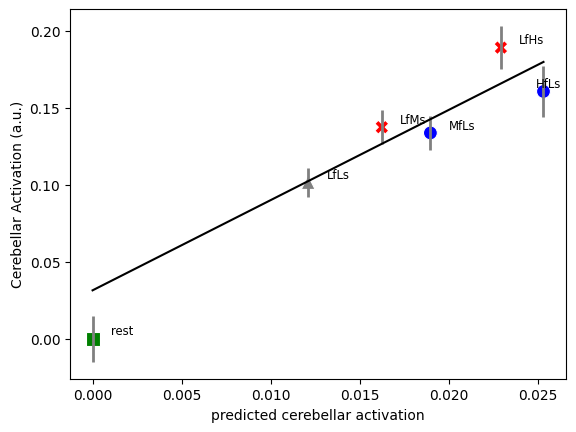

In [8]:
roi_name = 'M3R'

# D = ss.get_summary_conn(dataset="WMFS",
#                         ses_id='ses-01',
#                         type="CondHalf",
#                         cerebellum_roi='NettekovenSym68c32',
#                         cortex_roi="Icosahedron1002",
#                         add_rest=True)
# D = ra.run_regress(D, fit_intercept=True)
# D.to_csv(wkdir + '/fs_ROI_NettekovenSym68c32_conn_reg.tsv', sep='\t')

D = pd.read_csv(wkdir + '/fs_ROI_NettekovenSym68c32_conn_reg.tsv', sep='\t')
plotting.make_scatterplot(D.loc[D.roi_name == roi_name], split='cond_num',
                          labels=label_dict,
                          markers=marker_dict,
                          colors=color_dict)
plt.xlabel("predicted cerebellar activation")
print(AnovaRM(data=D[D.cond_name != 'rest'][D.roi_name == roi_name], depvar='res',
              subject='sn', within=['cond_name'], aggregate_func=np.mean).fit())

In [9]:
a = D.loc[D.roi_name == roi_name].loc[D.cond_name == "LH   "]
b = D.loc[D.roi_name == roi_name].loc[D.cond_name == "HL   "]
A = pd.pivot_table(a, values="res", index="sn", columns=None, aggfunc='mean', fill_value=None, margins=False, dropna=True, margins_name='All', observed=False, sort=True)
B = pd.pivot_table(b, values="res", index="sn", columns=None, aggfunc='mean', fill_value=None, margins=False, dropna=True, margins_name='All', observed=False, sort=True)

ttest_rel(A.res, B.res, nan_policy = 'omit')

TtestResult(statistic=2.812893307345984, pvalue=0.013113986042283095, df=15)

# selective recruitment: voxel-based
scatterplots and statistical tests on the residuals for each voxel.
* residuals are calculated with one single slope for all the voxels within the cerebellum

In [10]:
# Get the necessary data
## obesrved cerebellar data (Y)
## predicted cerebellar data (YP)
atlas_space='SUIT3'
Y,YP,cortex_atlas,info = load_data(ses_id = 'ses-01',
                                    subj = None,
                                    atlas_space='SUIT3',
                                    cortex = 'Icosahedron1002',
                                    type = "CondAll",
                                    mname = "MDTB_ses-s1_Icosahedron1002_L2Regression",
                                    reg = "A8",
                                    add_rest = True)
atlas_cereb,ainf = am.get_atlas(atlas_space, gl.atlas_dir)
# clean up the name string
info["cond_name"] = info["cond_name"].str.rstrip("   ")

In [11]:
# do regression and get residuals
res_c,coef_c,R2_c = ra.map_regress(YP,Y,fit_intercept=True,fit='common')

In [15]:
# calculate the mean and t-test for a specific residual
c_overall = np.ones(5,)/6
index1 = (info.speed==3)
c1 = np.zeros(6,)
c1[index1] = 1
index2 = (info.force == 3)
c2 = np.zeros(6,)
c2[index2] = 1

# Overall mean 
mean_overall,T_overall = calc_ttest_mean(res_c,c1-c2)
plot_data_flat(T_overall,atlas_cereb)

/home/ROBARTS/lshahsha/Documents/Projects/selective_recruitment/env/lib/python3.9/site-packages/SUITPy/flatmap.py:222: RuntimeWarning:

Mean of empty slice

